# Assignment 2

In [7]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import scipy.optimize as op
from __future__ import division
import warnings
warnings.filterwarnings("ignore")

### Combined .data and attributes into one csv and using that

In [2]:
df=pd.read_csv(r'C:\Users\Meet\Downloads\wdbc.data.csv')
df.head()

,Radius,Texture,Perimeter,Area,Smoothness,Compactness,Concavity,Concave_points,Symmetry,Fractal_dimension,...,W_Texture,W_Perimeter,W_Area,W_Smoothness,W_Compactness,W_Concavity,W_Concave_points,W_Symmetry,W_fractal_dimension,Diagnosis
0,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,0.2419,0.07871,...,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890,1
1,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,0.1812,0.05667,...,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902,1
2,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,0.2069,0.05999,...,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758,1
3,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,0.2597,0.09744,...,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300,1
4,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,0.1809,0.05883,...,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678,1


In [3]:
sns.set(style="ticks", color_codes=True)
g = sns.pairplot(df, palette = ('b', 'r'), hue="Diagnosis", height=2.5)
plt.show()

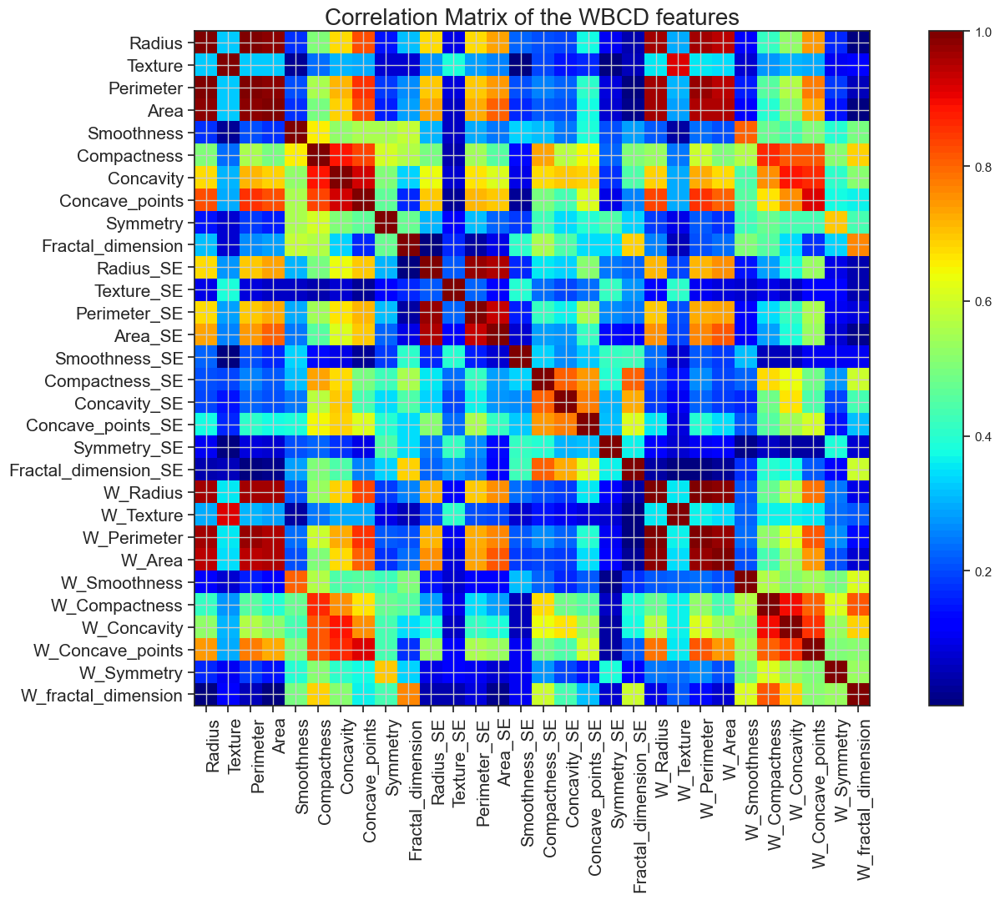

In [4]:
# Bivariate Analysis
# Make a Features Correlation Matrix of the WBCD features

def features_correlation_matrix(df):
    from matplotlib import pyplot as plt
    from matplotlib import cm as cm
    fig = plt.figure()
    fig.set_size_inches(18.5, 10.5)
    ax1 = fig.add_subplot(111)
    
    cmap = cm.get_cmap('jet', 100)
    
    cax = ax1.imshow(df.corr().abs(), interpolation="nearest", \
                     cmap=cmap)
    ax1.grid(True)
    plt.title('Correlation Matrix of the WBCD features',fontsize=20)
    labels=list(df.columns)
    
    ax1.set_xticks(np.arange(len(labels)))
    ax1.set_yticks(np.arange(len(labels)))
    
    ax1.set_xticklabels(labels,fontsize=15,\
              horizontalalignment="left", rotation='vertical')
    
    ax1.set_yticklabels(labels,fontsize=15)
    
    # Add a colorbar
    fig.colorbar(cax, ticks=[-1.0, -0.8, -0.6, -0.4, -0.2, 0, \
                             0.2, 0.4, 0.6, 0.8, 1])
    plt.show()


# Drop the Outcome column from Df and copy it into df_features
df_features = df.drop(df.columns[-1],axis=1)
# Run the correlation_matrix function, using df_features as argument
features_correlation_matrix(df_features)

In [8]:
# Dropping of features with a correlation greater than 0.9
# Create the correlation matrix with absolute values
corr_matrix = df_features.corr().abs()

# Select upper triangle of correlation matrix
upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(np.bool))

# Find index of feature columns with correlation greater than 0.9
to_drop = [column for column in upper.columns if any(upper[column] > 0.9)]
to_drop

['Perimeter',
 'Area',
 'Concave_points',
 'Perimeter_SE',
 'Area_SE',
 'W_Radius',
 'W_Texture',
 'W_Perimeter',
 'W_Area',
 'W_Concave_points']

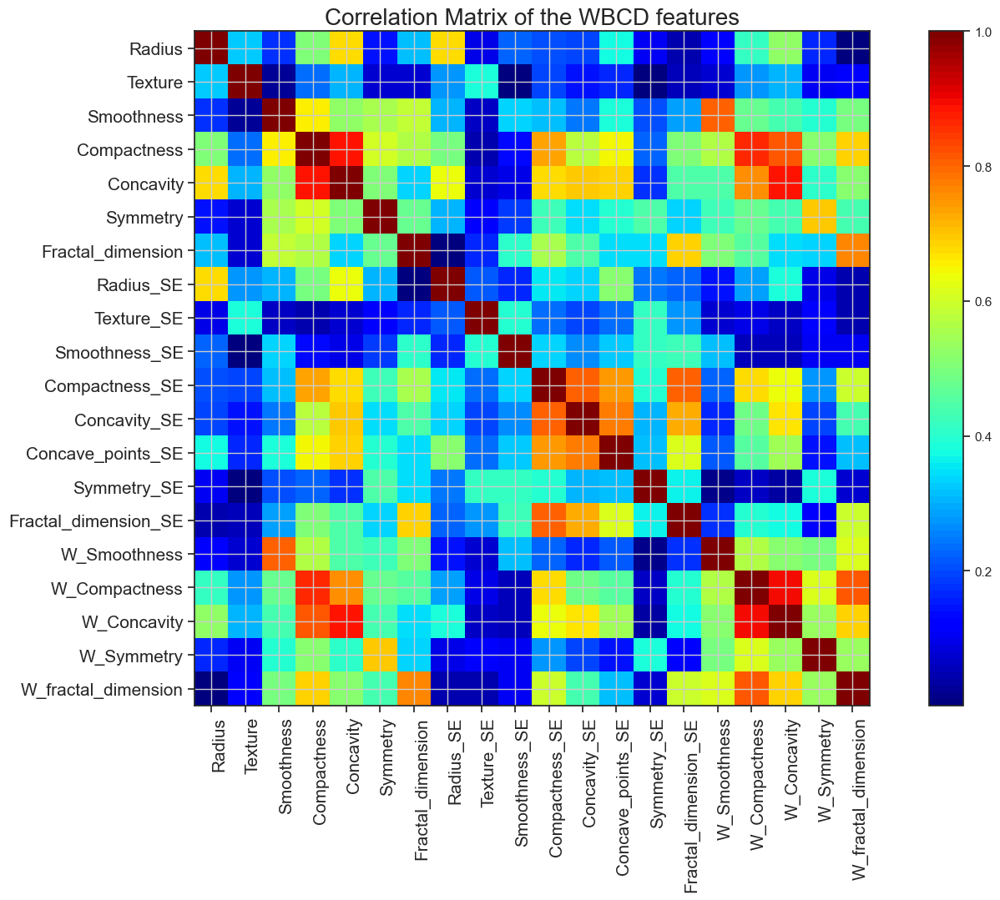

In [9]:
# Drop the redundant features from the df
df_features_corr_dropped = df_features.drop(df_features[to_drop], axis=1)

# Re-plot the dropped df containing only not-redundant features
# Using the feature_correlation_matrix() function
features_correlation_matrix(df_features_corr_dropped)

In [10]:
df_features_corr_dropped.corr().abs()

,Radius,Texture,Smoothness,Compactness,Concavity,Symmetry,Fractal_dimension,Radius_SE,Texture_SE,Smoothness_SE,Compactness_SE,Concavity_SE,Concave_points_SE,Symmetry_SE,Fractal_dimension_SE,W_Smoothness,W_Compactness,W_Concavity,W_Symmetry,W_fractal_dimension
Radius,1.000000,0.323782,0.170581,0.506124,0.676764,0.147741,0.311631,0.679090,0.097317,0.222600,0.206000,0.194204,0.376169,0.104321,0.042641,0.119616,0.413463,0.526911,0.163953,0.007066
Texture,0.323782,1.000000,0.023389,0.236702,0.302418,0.071401,0.076437,0.275869,0.386358,0.006614,0.191975,0.143293,0.163851,0.009127,0.054458,0.077503,0.277830,0.301025,0.105008,0.119205
Smoothness,0.170581,0.023389,1.000000,0.659123,0.521984,0.557775,0.584792,0.301467,0.068406,0.332375,0.318943,0.248396,0.380676,0.200774,0.283607,0.805324,0.472468,0.434926,0.394309,0.499316
Compactness,0.506124,0.236702,0.659123,1.000000,0.883121,0.602641,0.565369,0.497473,0.046205,0.135299,0.738722,0.570517,0.642262,0.229977,0.507318,0.565541,0.865809,0.816275,0.510223,0.687382
Concavity,0.676764,0.302418,0.521984,0.883121,1.000000,0.500667,0.336783,0.631925,0.076218,0.098564,0.670279,0.691270,0.683260,0.178009,0.449301,0.448822,0.754968,0.884103,0.409464,0.514930
Symmetry,0.147741,0.071401,0.557775,0.602641,0.500667,1.000000,0.479921,0.303379,0.128053,0.187321,0.421659,0.342627,0.393298,0.449137,0.331786,0.426675,0.473200,0.433721,0.699826,0.438413
Fractal_dimension,0.311631,0.076437,0.584792,0.565369,0.336783,0.479921,1.000000,0.000111,0.164174,0.401964,0.559837,0.446630,0.341198,0.345007,0.688132,0.504942,0.458798,0.346234,0.334019,0.767297
Radius_SE,0.679090,0.275869,0.301467,0.497473,0.631925,0.303379,0.000111,1.000000,0.213247,0.164514,0.356065,0.332358,0.513346,0.240567,0.227754,0.141919,0.287103,0.380585,0.094543,0.049559
Texture_SE,0.097317,0.386358,0.068406,0.046205,0.076218,0.128053,0.164174,0.213247,1.000000,0.397243,0.231700,0.194998,0.230283,0.411621,0.279723,0.073658,0.092439,0.068956,0.128215,0.045655
Smoothness_SE,0.222600,0.006614,0.332375,0.135299,0.098564,0.187321,0.401964,0.164514,0.397243,1.000000,0.336696,0.268685,0.328429,0.413506,0.427374,0.314457,0.055558,0.058298,0.107342,0.101480


In [11]:
# The Logistic Function
def sigmoid(z): 
    return 1 / (1 + np.exp(-z))

In [13]:
# Logistic Regression Cost Function
def calcCostFunction(theta, X, y):
    
    # number of training examples
    m,n = X.shape  
    
    # Calculate h = X * theta (we are using vectorized version)
    h = X.dot(theta) 
    
    # Calculate the Cost J
    J = -(np.sum(y * np.log(sigmoid(h)) + (1 - y) * np.log(1 - sigmoid(h)))/m)
    return J

In [14]:
# The Gradient Function
def calcGradient(theta, X, y):
    
    # number of training examples
    m,n = X.shape    
    
    # Calculate h = X * theta
    h = X.dot(theta)
    
    # Calculate the error = (h - y)
    error = sigmoid(h) - y
    
    # Calculate the new theta
    gradient = 1/m * (X.T).dot(error)
    
    return gradient

In [15]:
def FeatureScalingNormalization(X):
    X_norm = X 
    mu = np.zeros(X.shape[1]) 
    sigma = np.zeros(X.shape[1]) 

    mu = np.vstack((X[0].mean(), \
                    X[1].mean()))

    sigma = np.vstack((X[0].std(ddof=1),\
                       X[1].std(ddof=1)))     

    m = X.shape[1] 
    mu_matrix = np.multiply(np.ones(m), mu).T    
    sigma_matrix = np.multiply(np.ones(m), sigma).T
    
    X_norm = np.subtract(X, mu).T
    X_norm = X_norm /sigma.T
    
    return [X_norm, mu, sigma]

In [16]:
def CalcAccuracy(theta, X):
    p = sigmoid(X.dot(theta)) >= 0.5
    return p

In [17]:
# Radius and Texture
X = np.vstack((np.asarray(df.Radius.values), \
               np.asarray(df.Texture.values)))
y = np.asarray(df.Diagnosis.values)

Text(0, 0.5, 'Texture')

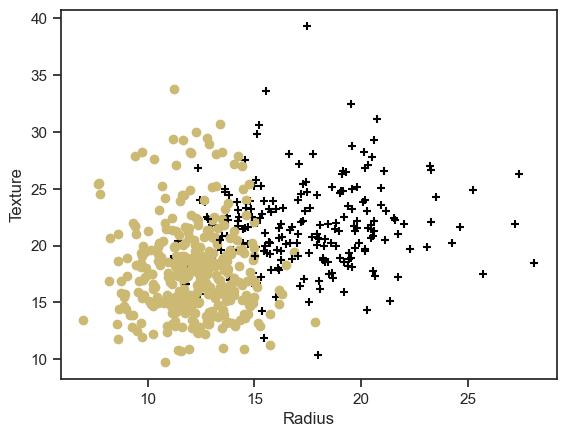

In [18]:
# Plot the data
for i in range(len(y)):
    if y[i]==0.0:
        c = 'y'
        m = u'o'
    if y[i]==1.0:
        c = 'black'
        m = u'+'
    plt.scatter(X[0][i], X[1][i], color=c, marker=m)

plt.xlabel(df.columns[df.columns.get_loc("Radius")])
plt.ylabel(df.columns[df.columns.get_loc("Texture")])

In [19]:
# Normalize X using the FeatureScalingNormalization function, and 
# copy the results in the "featuresNormalizeresults" list
featuresNormalizeresults = FeatureScalingNormalization(X)

X = np.asarray(featuresNormalizeresults[0]).T
mu = featuresNormalizeresults[1]
sigma = featuresNormalizeresults[2]

In [20]:
# Add a column of 'ones' to X

m = len(y) 
n = len(X)

# Add a column of ones to the X matrix
X = np.vstack((np.ones(m), X)).T

In [21]:
# First test: Compute cost and gradient, 
# and display the updated theta starting with initial theta = [0, 0, 0]

initial_theta = np.zeros(n+1); # set theta = [0, 0, 0]

print ("J", calcCostFunction(theta=initial_theta, X=X, y=y))
print ("grad", calcGradient(theta=initial_theta, X=X, y=y))

J 0.6931471805599453
grad [ 0.12741652 -0.35265304 -0.20056252]


In [22]:
# Second test: Compute cost and gradient, 
# and display the updated theta starting with a non-zero theta

test_theta = [-24, 1.2, 0.2];

print ("J", calcCostFunction(theta=initial_theta, X=X, y=y))
print ("grad", calcGradient(theta=initial_theta, X=X, y=y))

J 0.6931471805599453
grad [ 0.12741652 -0.35265304 -0.20056252]


### optimization

In [23]:
# Gradient Descent Advanced Optimization: BFGS
# Update and find the optimal theta
m , n = X.shape;
initial_theta = np.zeros(n);
Result = op.minimize(fun = calcCostFunction, 
                                 x0 = initial_theta, 
                                 args = (X, y),
                                 method = 'BFGS',
                                 jac = calcGradient);
theta = Result.x;
Result

      fun: 0.2558201286363281
 hess_inv: array([[12.66527269, -1.22908954, -2.82539649],
       [-1.22908954, 71.16261306,  7.07658929],
       [-2.82539649,  7.07658929, 13.39777084]])
      jac: array([7.36409258e-07, 3.24760454e-08, 9.55291040e-07])
  message: 'Optimization terminated successfully.'
     nfev: 20
      nit: 19
     njev: 20
   status: 0
  success: True
        x: array([-0.70755981,  3.72528774,  0.93824469])

Text(0, 0.5, 'Texture')

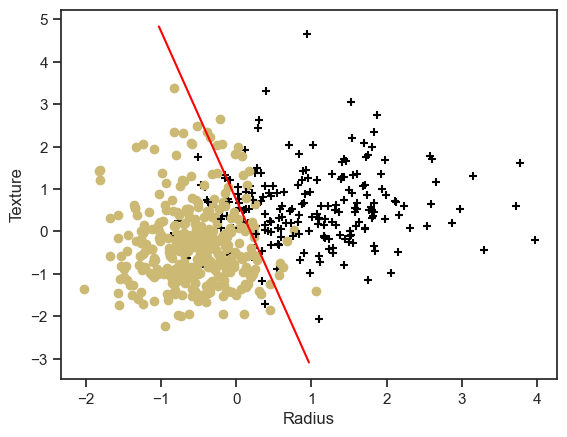

In [24]:
# Plot the data with the 
# Logistic Regression Decision Boundary

# Create a plot set
plot_x = np.asarray([X.T[1].min()+1, X.T[1].max()-3])

# Calculate the Decision Boundary
plot_y = (-1/theta[2]) * (theta[1] * plot_x + theta[0])

for i in range(len(y)):
    if y[i]==0.0:
        c = 'y'
        m = u'o'
    if y[i]==1.0:
        c = 'black'
        m = u'+'
    plt.scatter(X.T[1][i], X.T[2][i], color=c, marker=m) 
    
# Plot the Decision Boundary (red line)
plt.plot(plot_x, plot_y, color='red')

# Put labels
plt.xlabel(df.columns[df.columns.get_loc("Radius")])
plt.ylabel(df.columns[df.columns.get_loc("Texture")])

In [25]:
# Calculate accuracy
p = CalcAccuracy(theta, X)
p = (p == y) * 100
print ("Train Accuracy:", p.mean())

Train Accuracy: 89.103690685413


In [26]:
# Perform a Query:
# Predict the risk of malignancy for Radius = 18.00 and Texture = 10.12

query = np.asarray([1, 18.00, 10.12])

# Scale and Normalize the query
query_Normalized = \
np.asarray([1, ((query[1]-float(mu[0]))/float(sigma[0])),\
                               ((query[2]-float(mu[1]))/float(sigma[1]))])


prediction = sigmoid(query_Normalized.dot(theta));
prediction

0.7999520268226942